<a href="https://colab.research.google.com/github/avivajpeyi/Bayesian_Lectures/blob/master/toyModel_likelihoodEval.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/googlecolab/colabtools/blob/master/notebooks/colab-github-demo.ipynb)



##### Setup for project


In [164]:
# testing GPU connection
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found; Go to Runtime > Change Runtime Type > Harware Accelerator > GPU')
print('Found GPU at: {}'.format(device_name))


Found GPU at: /device:GPU:0


In [165]:
! pip install emcee;
! pip install corner;
! pip install h5py pyyaml ;

# doc tool
from typing import List, Optional, Callable

# shell commands 
import subprocess
import os

# ML Imports
import torch
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.python import keras
from keras.layers import Dense, Activation
from keras.models import Sequential, Model
from keras.layers.advanced_activations import LeakyReLU
import json

# Statistics Imports
import numpy as np
import cupy as cp
import scipy 
from scipy.stats import norm
from scipy.special import logsumexp
from scipy.stats import uniform
import pandas as pd
import random

# Preferences
# font = {'family' : 'sans serif', 'weight': 'regular', 'size'   : 40}
# rc('font', **font)
# plt.rcParams['figure.figsize'] = (0.4*8*1.9, 0.4*1.9*4*1.2)
np.random.seed(100)


# Plotting imports
import pylab as plt
import plotly.graph_objs as go
from plotly.offline import iplot, plot
from plotly import tools as plotly_tools
%matplotlib inline
from IPython.display import set_matplotlib_formats
from IPython.display import clear_output
set_matplotlib_formats('retina')
from matplotlib.ticker import MaxNLocator
import matplotlib.ticker as mtick
from matplotlib import rc
import corner
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

# Sampling tool
import emcee


def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML(''' <script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)
  





In [0]:
# function to run shell comands
def execute_in_shell(command=None, 
                     verbose = False):
    """ 
        command -- keyword argument, takes a list as input
        verbsoe -- keyword argument, takes a boolean value as input
    
        This is a function that executes shell scripts from within python.
        
        Keyword argument 'command', should be a list of shell commands.
        Keyword argument 'versboe', should be a boolean value to set verbose level.
        
        Example usage: execute_in_shell(command = ['ls ./some/folder/',
                                                    ls ./some/folder/  -1 | wc -l'],
                                        verbose = True ) 
                                        
        This command returns dictionary with elements: Output and Error.
        
        Output records the console output,
        Error records the console error messages.
                                        
    """
    error = []
    output = []
    
    if isinstance(command, list):
        for i in range(len(command)):
            try:
                process = subprocess.Popen(command[i], shell=True, stdout=subprocess.PIPE)
                process.wait()
                out, err = process.communicate()
                error.append(err)
                output.append(out)
                if verbose:
                    print ('Success running shell command: {}'.format(command[i]))
            except Exception as e:
                print ('Failed running shell command: {}'.format(command[i]))
                if verbose:
                    print(type(e))
                    print(e.args)
                    print(e)
                
    else:
        print ('The argument command takes a list input ...')
    return {'Output': output, 'Error': error }
  
  
def benchmark(func, args, n_run):
    """
    Parameters
    ----------
    func: function, the function to be benchmarked
    args: tuple, the arguments to be passed to the function
    n_run: int, the number of times the function should be run

    Returns
    -------
    List[int] of times it takes for the function to run
    """
    times = []
    for _ in range(n_run):
        start = cp.cuda.Event()
        end = cp.cuda.Event()
        start.record()
        func(*args)
        end.record()
        end.synchronize()
        times.append(cp.cuda.get_elapsed_time(start, end))  # milliseconds
    return times
  


In [167]:
# Mount Gdrive in your virtual env
# do this only once
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [0]:
# FILE NAMES
PATH = "/gdrive/My Drive/likelihoodToyModel"


def make_data_folders(main_dir:str,id_str:str):
  """
  @param data_id_num: the 
  """
  
  main_dir = os.path.join(PATH, main_dir)
  
  di_dir = f"{id_str}"
  di_dir = os.path.join(main_dir, di_dir)
  samples_csv_p = os.path.join(di_dir, f"samples_{id_str}_df.csv")
  samples_np_p = os.path.join(di_dir, f"samples_{id_str}_nparray.npy")
  nn_samples_csv_p = os.path.join(di_dir, f"nn_samples_{id_str}_df.csv")
  nn_samples_np_p = os.path.join(di_dir, f"nn_samples_{id_str}_nparray.npy")
  
  model_p = os.path.join(di_dir, f"model_{id_str}.h5")
  hist_p = os.path.join(di_dir, f"hist_{id_str}.csv")
  training_acc_p=os.path.join(di_dir, f"model_acc_{id_str}.html")
  training_test_p=os.path.join(di_dir, f"model_test_{id_str}.html")
  
  cp_dir = f"checkpoints_{id_str}"
  cp_dir = os.path.join(di_dir, cp_dir)
  cp_p = os.path.join(cp_dir, f"cp_{id_str}.ckpt")
  out = execute_in_shell(command=['''mkdir -p "{}"'''.format(di_dir),
                                  
                                  '''mkdir -p "{}"'''.format(cp_dir)])
  
  path_dict = dict(
      samples_csv_p=samples_csv_p,
      samples_np_p=samples_np_p,
      model_p=model_p,
      hist_p=hist_p, 
      cp_p=cp_p,
      training_acc_p=training_acc_p,
      training_test_p=training_test_p,
      nn_samples_csv_p=nn_samples_csv_p,
      nn_samples_np_p=nn_samples_np_p
  )
  
  return path_dict

In [0]:
path_dict = make_data_folders(main_dir="full_dataset",id_str="full")
samples_csv_p=path_dict.get('samples_csv_p')
samples_np_p=path_dict.get('samples_np_p')
model_p=path_dict.get('model_p')
hist_p=path_dict.get('hist_p')
cp_p=path_dict.get('cp_p')
training_acc_p=path_dict.get('training_acc_p')
training_test_p=path_dict.get('training_test_p')
nn_samples_csv_p=path_dict.get('nn_samples_csv_p')
nn_samples_np_p=path_dict.get('nn_samples_np_p')

##### Flags

In [0]:
load_mcmc_samples = True
load_model_data = True
save_plot = False
load_nn_mcmc_samples = True


# Likelihood Interpolant
---
Rory Smith, Avi Vajpeyi







## Defining the signal and noise

Consider a singal modeled in time $t_i$ by the line equation,

>* $s\, (t_i;m, c) = m t_k + c$

and that the signal is hidden in the data with some gaussian noise,

>* $n\, (t_i; \mu, \sigma) \sim  \mathcal{N}(t_i; \mu,\,\sigma^{2}) = \frac{1}{{\sqrt {2\pi \sigma^2} }}e^{\frac{{ - \left( {t_i - \mu } \right)^2 }}{2\sigma^2}} $

>* $d\,(t) = s\, (t_i;m, c) + n\, (t_i; \mu, \sigma)$  .

Assume that 
*  $\mu=0,\  \sigma=1$
*  $m=0.1,\ c=0.5$ ,

and that $d\,(t_i)$ was recorded at every second, for 10 seconds. 

These equations can be seen in code below, with a visulisation of the signal and data in a plot. 




In [0]:
# "True" model parameters
m_true = -0.9594         # line slope of straight-line component
c_true = 4.3             # size of the power-law component
sigma_noise_true = 0.534 # std. dev. on noise (noise is Gaussian)
mu_noise_true = 9.5      # mean of noise (noise is Gaussian)

# Ranges of the parameters
m_min, m_max = -2, 2
c_min, c_max = 2, 20
mu_min, mu_max = 6, 12
sigma_min, sigma_max = 0.1, 2

# Tabulate the true values
def parameter_summary():
  true_vals_dataframe = pd.DataFrame(
    {
        "Param": ['m','c','sigma','mu'],
        "True": [m_true, c_true, sigma_noise_true, mu_noise_true],
        "Min": [m_min, c_min, sigma_min, mu_min],
        "Max": [m_max, c_max, sigma_max, mu_max],
    }, columns=["Param", "True","Max","Min"])
  
  display(true_vals_dataframe)
  pass


# Generate some synthetic data from the model.
def noise_model(mu, sigma, N):
  return np.random.normal(loc=mu, scale=sigma, size=N)  

def line_model(x,m,c):
    return m*x + c

def generate_data(N, splits):
  x = np.sort(10*np.random.rand(N)) # x-values (independent variable)  
  noise = noise_model(mu_noise_true, sigma_noise_true, N)
  sig = line_model(x,m_true,c_true)
  y = sig + noise
  data_dict = dict(x=x, y=y, sig=sig)
  
  split_x = np.split(x, splits)
  split_y = np.split(y, splits)
  split_sig = np.split(sig, splits)
  
  data_dicts = []
  for i in range(0, splits):
    data_dicts.append(dict(x=split_x[i], y=split_y[i], sig=split_sig[i]))
  
  return data_dict, data_dicts 
  
  
# visualising the data
def models_plot(data_dicts:List[dict]):
  enable_plotly_in_cell()
  
  all_x = np.concatenate([d['x'] for d in data_dicts])
  all_y = np.concatenate([d['y'] for d in data_dicts])
  all_sig = np.concatenate([d['sig'] for d in data_dicts])
  
  traces = []
  
  trueData = go.Scatter(x = all_x, y = all_y,  line = dict(dash = 'dash'), name = 'data = signal+noise')
  traces.append(trueData)
  
  for idx, d in enumerate(data_dicts):
    trace = go.Scatter(x = d.get('x'), y = d.get('y'), mode = 'markers', name = r"data_{}".format(idx))
    traces.append(trace)
      
  trueSignal = go.Scatter( x = all_x, y = all_sig, mode = 'lines+markers', name = 'signal')
  traces.append(trueSignal)

  
  
  layout = dict(
      title = 'Visulising the true signal and data',
      xaxis = dict(title = 'Time (s)'),
      yaxis = dict(title = 'Aplitude'),
      )
  fig = dict(data=traces, layout=layout)
  pass
  
  iplot(fig, filename='signal_and_raw_data.html')
  # plot(fig, filename='signal_and_raw_data.html') saves html file 

In [230]:
# Generate and visualise Data
data_dict, data_dicts = generate_data(N=10, splits=2) 
models_plot(data_dicts)
parameter_summary()

,Param,True,Max,Min
0,m,-0.9594,2,-2.0
1,c,4.3000,20,2.0
2,sigma,0.5340,2,0.1
3,mu,9.5000,12,6.0


Assume that the parameters $m$ and $c$ of $s\, (t_i;m, c)$ are unknown. The goal is to determine the values of $m$ and $c$ using 
* the $d\,(t_i)$ that has been been collected for 10 points of time
* knowledge of the models for the signal and noise
* prior knowledge of the ranges of potential values for $m$ and $c$ ($m\in [-1,1]$ and $c\in[-1,1] $). 

One techinque of determining the parameters is by using Bayesian Inference.

## Bayesian Inference for Parameter Estimation




Bayes theorem states that 

> $p(\theta | d, \mathcal{H}_i) = \frac{\pi(\theta)\ \mathcal{L}(d|\theta, \mathcal{H}_i)}{Z(d|\mathcal{H}_i)}$,

where

* $\theta$ is a vector of parameters 
> In this case $\theta=\{m,c\}$



* $\mathcal{H}_i$ is the mathematical model that is believed to represent the data
> This case's hypothesis is that if we subtract out our signal model from the data, all that will remain is Gaussian noise, given by $\ \mathcal{H}: n\,(t_i) = d(t_k) -s\,(t_i;m, c)$.



* $p(\theta | d, \mathcal{H}_i)$ is the Posterior Probability of the parameters given the data and hypothesis, a distribution of probabilities for the various potential values of $\theta$. 



* $\pi(\theta)$ is the prior probability of the parameters, and is obtained from existing knowledge (before analysing the data).
> Here  $\pi(m)=\text{Uniform}(-1,1)\ $ and $\ \pi(c)=\text{Uniform}(-1,1)$, 
> Thus $\pi(\theta) = \pi(m)\pi(c)= \text{Uniform}(-1,1)\ \text{Uniform}(-1,1)$



* $Z(d|\mathcal{H}_i)$ is the evidence of the data given the hypothesis $\mathcal{H}_i$. 
> Becasue the Posterior Probability of the parameters is normalised by the evidence of the data, integrating $p(\theta | d, \mathcal{H}_i)$ over the parameter space of $\theta$ equals one:
> $1=\int_{\theta}\  p(\theta|d,\mathcal{H}_i) \ d\theta$
> $\implies Z(d|\mathcal{H}_i)= \int_{\theta}\ \pi(\theta)\, \mathcal{L}(d|\theta, \mathcal{H}_i)\ d\theta\ $.
>In this case, to calculate the evidence of the signal hypothesis, we can calculate a 2D integral over $m$ and $c$:
> $Z(d|\mathcal{H}_S) =\int_m\int_c \, \pi(m,c)\, \mathcal{L}(d|(m,c), \mathcal{H}_i)\ dm\,dc\,$
> which in log form can be written as
>  $\ln Z(d|\mathcal{H}_S) =\int_m\int_c \, \big(\ln \pi(m,c)\, +\ln \mathcal{L}(d|(m,c), \mathcal{H}_i)\ \big)dm\,dc\,$

* $\mathcal{L}(d|\theta, \mathcal{H}_i)$ is the likelihood of data given the parameters and hypothesis.
>  Additionally because $n\,(t_i)=\mathcal{N}(t_i; \mu,\,\sigma^{2})$, the $\mathcal{L}(d|\theta, \mathcal{H}_i)$ becomes a conceptually easy calculation -- it is a normal distribution, and can be written as 
>$\mathcal{L}(d|\theta,\mathcal{H}_S) = \prod_{t_i} \text{Normal}_{\text{PDF}}\big(\left[d(t_i) - s(t_i;\theta=\{m,c\}\big)\right]; \mu,\sigma)$
>$\implies\mathcal{L}(d|\theta,\mathcal{H}_S) = \prod_{t_i} \text{Normal}_{\text{PDF}}(\left[d(t_i) - (mt_i+c)\right]; \mu,\sigma)$.

> The reason why $\mathcal{L}(d|\theta, \mathcal{H}_i)$ is still tricky to solve is because the values of $\theta=\{m,c\}$ are unknown and so it is required to calculate $\mathcal{L}(d|\theta,\mathcal{H}_S)$ for a large set of possible combinations of $\theta$. In this case where $size(\theta)=2$ and there are not a very large number of combinations of $\theta$, this does not seem like something to be concerened about. However, more complex models have more parameters, and so the size of the parameter space can increase exponentially, making $\mathcal{L}(d|\theta, \mathcal{H}_i)$ a computational challenge. 

Before delving into a techinque to help calculate $\mathcal{L}(d|\theta,\mathcal{H}_S)$, consider the code below demonstrating an implementation the concepts just discussed. Note that everything will be coded in Log form, to make calculations simpler.

In [0]:
def ln_prior(theta):
    m, c = theta[0], theta[1]
    mu, sigma = mu_noise_true, sigma_noise_true
    
    in_m_range     = m_min     <= m     and m     <= m_max
    in_c_range     = c_min     <= c     and c     <= c_max
    in_mu_range    = mu_min    <= mu    and mu    <= mu_max
    in_sigma_range = sigma_min <= sigma and sigma <= sigma_max
   
    if in_m_range and in_c_range and in_mu_range and in_sigma_range:
        ln_pi_m = uniform.logpdf(m, loc=m_min, scale=m_max)
        ln_pi_c = uniform.logpdf(c, loc=c_min, scale=c_max)
        ln_pi = ln_pi_m + ln_pi_c
    else: 
        ln_pi = -np.inf

    return ln_pi
  
  
def ln_like(theta, data_dict, line_model):
    m, c = theta[0], theta[1]
    mu, sigma = mu_noise_true, sigma_noise_true
    
    sig = line_model(data_dict['x'], m,c)
    res = data_dict['y']-sig
    _lnL_d_i = norm.logpdf(res,loc=mu,scale=sigma)
    lnL = np.sum(_lnL_d_i)
    return lnL
  
  
def ln_prob(theta, data_dict, line_model):
    m, c = theta[0], theta[1]
    mu, sigma = mu_noise_true, sigma_noise_true
    
    ln_pi = ln_prior(theta)
    lnL = ln_like(theta, data_dict, line_model)
    ln_prob = lnL + ln_pi   
    return ln_prob
  
def ln_evidence(twoD_log_post_prob, dm, dc):
  ln_evid = logsumexp(twoD_log_post_prob, b=dc*dm)
  print(f"Log Evidence: {ln_evid}")
  return ln_evid
  
# Brute force way of getting post_prob; not looping over the mu and sigma
@np.vectorize
def post_prob_brute_force(mm,cc):
  theta = [mm, cc, mu_noise_true, sigma_noise_true]
  log_post = ln_prob(theta, data_dict, line_model)
  post = np.exp(log_post)
  return post

In [0]:
# PLOTTING POST PROB
          
def plot_contour(Z, title="Post Prob"):
  enable_plotly_in_cell()
  # Contour data
  contour_data = [{'z': Z, 'colorscale':'Jet', 'type': u'contour',
                 'dx': (m_max-m_min)/100,  'x0': m_min, 
                 'dy': (c_max-c_min)/100, 'y0': c_min, },]
  # True data
  true_lines = [{'type': 'line','x0': m_min,'y0': c_true,'x1': m_max,'y1': c_true,},
                {'type': 'line', 'x0': m_true, 'y0': c_min,'x1': m_true,'y1': c_max}]
  
  true_annotation = dict(x=m_true, y=c_true,xref='x', yref='y',
                          text='True Vals (m={}, c={})'.format(m_true,c_true),
                          showarrow=True, arrowhead=7,
                          ax=0, ay=-40,
                          font = dict(color = "black", size = 12 ),
                          bgcolor='#c7c7c7', opacity=0.8)

  # Setting preferences
  layout = go.Layout(title=title,
                      xaxis = dict(title = 'm', range=[-1.1, -0.8]),
                      yaxis = dict(title = 'c', range=[3,5.2]),
                      showlegend=False,
                      shapes = true_lines,
                      annotations=[true_annotation])
  
  # ploting
  fig = go.Figure(data=contour_data, layout=layout)
  iplot(fig, filename=title)
  pass


def plot_post_prob(title:str, post_prob_funct:Callable, *argv, **kwargs):
  m_vec, c_vec = np.linspace(m_min, m_max, 100), np.linspace(c_min, c_max, 100)
  m_grid, c_grid = np.meshgrid(m_vec,c_vec)
  dm, dc = m_vec[1]-m_vec[0], c_vec[1]-c_vec[0]
  post_prob_grid = post_prob_funct(m_grid,c_grid, *argv, **kwargs)
  plot_contour(post_prob_grid, title=title)
  return post_prob_grid, dm, dc


If we brute force calculate $\mathcal{L}(d|\theta, \mathcal{H}_i)$ at all the possible values for $\theta$ we can get a distribution as shown in the following.

In [175]:
pp_grid, dm, dc = plot_post_prob("Brute Force Posterior Probability", post_prob_funct=post_prob_brute_force)

In [176]:
ln_e = ln_evidence(pp_grid, dm, dc)

Log Evidence: 4.2967670646736424


## MCMC to sample $\ln \mathcal{L}(d|\theta)$ 
Define parameters for MCMC

In [177]:
N_DIM, N_WALKERS, N_STEPS = 2, 100, 2000
BURNIN_AMOUNT = 1500
total_number_of_samples = N_STEPS*N_DIM*N_WALKERS
print("Total number of steps: {}".format(total_number_of_samples))

Total number of steps: 400000


In [0]:

def set_up_mcmc_sampler(ln_prob_func:Callable,
                        func_args:Optional[List]=[],
                        ndim:Optional[int]=N_DIM,
                        nwalkers:Optional[int]=N_WALKERS, ):
  """
  Set up for MCMC
  """
  starts = [0,4] ## IF I DONT USE THIS AS STARTING POINT, I GET WEIRD MCMC
  walker_starting_pos = [starts + 1e-2*np.random.normal(size=ndim) for i in range(nwalkers)]
  sampler = emcee.EnsembleSampler(nwalkers, ndim, ln_prob_func, args=func_args)
  return walker_starting_pos,sampler

def do_sampling(ln_prob_func:Callable, 
                func_args:Optional[list]=[],
                ndim:Optional[int]=N_DIM,
                nwalkers:Optional[int]=N_WALKERS, 
                nsteps:Optional[int]=N_STEPS,
                burnin_amount:Optional[int]=BURNIN_AMOUNT, ):
  # do MCMC
  walker_starting_pos, sampler = set_up_mcmc_sampler(ln_prob_func, func_args)
  sampler.run_mcmc(walker_starting_pos, nsteps)
  
  # collect MCMC data
  samples = sampler.chain[:, burnin_amount:, :].reshape((-1, ndim))
  samples_dataframe = pd.DataFrame({
        "m": sampler.flatchain[burnin_amount:,0],
        "c": sampler.flatchain[burnin_amount:,1],
        "likelihood": sampler.flatlnprobability[burnin_amount:]
    }, columns = ["m","c","likelihood"])
  
  # IS THIS OK???
  # cleaning up data
  samples_dataframe = samples_dataframe.replace([np.inf, -np.inf], np.nan).dropna()
  
  # sanity check of data
  samples_dataframe.describe().transpose()
  
  return samples, samples_dataframe

In [0]:
# loading and saving data

def save_mcmc_samples_data(samples, samples_dataframe, df_path, np_path):
  # save data
  np.save(np_path, samples)
  samples_dataframe.to_csv(df_path,index=False, index_label= False)
  # making sure successful saving to drive
  exists = os.path.isfile(df_path) and os.path.isfile(np_path)
  if not exists:
    raise Exception('File not properly saved at {}'.format(df_path))
    
  pass


def load_mcmc_samples_data(df_path, np_path):
  # loading data
  samples = np.load(np_path)
  samples_dataframe = pd.read_csv(df_path)
  samples_dataframe = samples_dataframe.replace([np.inf, -np.inf], np.nan).dropna()
  # sanity check of data
  samples_dataframe.describe().transpose()
  return samples, samples_dataframe

def get_mcmc_samples(load_previous_data:bool,
                     df_path:str,
                     np_path:str,
                     ln_like_func:Callable,
                     func_args:Optional[list]=[],):
  if load_previous_data:
    samples, samples_df = load_mcmc_samples_data(df_path=df_path, np_path=np_path)
  else:
    samples, samples_df = do_sampling(ln_like_func, func_args=func_args)
    save_mcmc_samples_data(samples, samples_df, df_path=df_path, np_path=np_path)
  return samples, samples_df


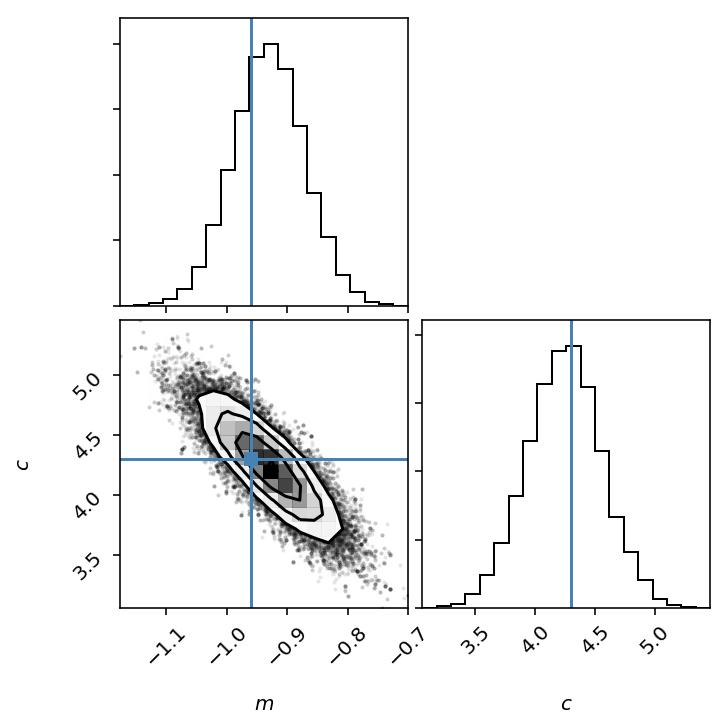

In [180]:
samples, samples_dataframe = get_mcmc_samples(
    load_previous_data=load_mcmc_samples, 
    df_path=samples_csv_p,
    np_path=samples_np_p,
    ln_like_func=ln_like,
    func_args=[data_dict, line_model])

  
# Visulaise sample results
fig = corner.corner(
    samples,
    labels=["$m$", "$c$",],
    truths=[m_true, c_true, ]
)

## NN for $\ln \mathcal{L}(d|\theta)$


### Converting samples data into ML training and testing data


**(1) Split data**

First, data is split into
- 80% Train (20% of this is used as during training validation)
- 20% Test


**(2)Split target feature from data**

The target value, or "label", are removed from the features of the datasets. This label is the value that the model is trained to predict.


**(3) Normalise data**

The datasets are then normalised, to reduce  the large difference in the ranges of each feature.It is good practice to normalize features that use different scales and ranges. Although the model might converge without feature normalization, it makes training more difficult, and it makes the resulting model dependent on the choice of units used in the input.


In [0]:
def get_dataframe_stats(df, target_label ):
  stats = df.copy()
  stats.pop(target_label)
  stats = stats.describe().transpose()
  return stats.get('mean'), stats.get('std')

def normalise_ml_data(data, mean, std):
  normalised_x = (data - mean) / std
  return normalised_x
  
def get_ml_data(df, target_label):
  # 1) split data
  train_dataset = df.sample(frac=0.8,random_state=0)
  test_dataset = df.drop(train_dataset.index)
  
  # 2) extract the "target" feature from dataset
  train_labels = train_dataset.pop(target_label)
  test_labels = test_dataset.pop(target_label)
  
  # 3) normalise data  UNUSED ATM
  mean, std = get_dataframe_stats(df, target_label)
  norm_train_dataset = normalise_ml_data(train_dataset, mean, std)
  norm_test_dataset = normalise_ml_data(test_dataset, mean, std)
  
  return train_dataset, train_labels, test_dataset, test_labels


In [182]:
train_dataset, train_labels, test_dataset, test_labels = get_ml_data(samples_dataframe, 'likelihood')
train_dataset.describe().transpose()


,count,mean,std,min,25%,50%,75%,max
m,158800.0,-0.919505,0.107981,-1.415322,-0.969313,-0.929112,-0.888311,0.022987
c,158800.0,4.238628,0.315361,1.404967,4.026269,4.237618,4.446346,7.784341


### Build the model
Let's build our model. We'll use a *Sequential model* with 
 * two densely connected hidden layers,
 * an output layer that returns a single, continuous value.
 
 We can do a quick sanity check of the untrained model by feeding in some testing data to it once built.


--- 
Note: while training if you get Nan for loss, refer to [this](https://stackoverflow.com/questions/37232782/nan-loss-when-training-regression-network). 



In [0]:
def build_model():
  model = keras.Sequential([
    layers.Dense(64, activation=tf.nn.relu, input_shape=[len(train_dataset.keys())]),
    layers.Dense(64, activation=tf.nn.relu),
    layers.Dense(1)
  ])

  rms_optimizer = tf.keras.optimizers.RMSprop(0.001)
  
  model.compile(loss='mean_squared_error',
                optimizer=rms_optimizer,
                metrics=['mean_absolute_error', 'mean_squared_error']) 
  return model


def simple_test_of_model(model, test_data, test_labels, verbose=False):
  example_result = model.predict(test_data).flatten()
  assert np.isfinite( example_result ).all()
  assert not np.isnan( example_result ).all()
  
  loss, mae, mse = model.evaluate(test_data[:10], test_labels[:10], verbose=0)
  if verbose:
    print("Model Mean Abs Error: +/- {:5.2f} ln like".format(mae))
  return mae 

In [184]:
model = build_model()
model.summary()
mae = simple_test_of_model(model, test_dataset[:10], test_labels[:10], verbose=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_66 (Dense)             (None, 64)                192       
_________________________________________________________________
dense_67 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_68 (Dense)             (None, 1)                 65        
Total params: 4,417
Trainable params: 4,417
Non-trainable params: 0
_________________________________________________________________
Model Mean Abs Error: +/-  5.66 ln like


Note that it seems to be working, and it produces a result of the expected type (albeit with bad accuracy)

### Train and Test model
Train the model for 1000 epochs, and record the training and validation accuracy in the history object.

In [0]:
def train_model(model, train_data, train_labels, checkpoint_path, EPOCHS=100,  verbose=0):
  
  # Callbacks
  
  # progress callback
  class PrintDot(keras.callbacks.Callback):
    """
    single dot for each completed epoch
    newline every 100 trained points
    """
    def on_epoch_end(self, epoch, logs):
      if epoch % 100 == 0: print('')
      print('.', end='')

  # Earlt stop callback
  early_stop = keras.callbacks.EarlyStopping(
      monitor='val_loss', # Training will stop when 'val_loss' stops improving
      verbose=1,
      patience=30 # Num Epochs to check for improvement
  )

  # create checkpoint callback
  checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
      checkpoint_path, 
      save_weights_only=True,
      period=50, # Save weights, every 50-epochs.
      verbose=verbose)
  
  history = model.fit(
      x=train_data,
      y=train_labels,
      batch_size=128,
      epochs=EPOCHS,
      validation_split = 0.2,
      verbose=verbose,
      callbacks=[checkpoint_callback, early_stop, PrintDot()]
  )


  return model, history


def test_model(model, hist_df, test_df, test_labels, fname='model_testing.html', save_plot=False):
  enable_plotly_in_cell()

  mae = simple_test_of_model(model, test_df, test_labels,verbose=False)
  
  test_predictions = model.predict(test_df).flatten()
  
  mae_train, mae_val = (hist_df['mean_absolute_error'], hist_df['val_mean_absolute_error'])
  mse_train, mse_val = (hist_df['mean_squared_error'], hist_df['val_mean_squared_error'])
  
  trace1 = go.Scatter(x =test_labels, y =test_predictions , mode='markers', showlegend=False, name = 'Prediction VS Obs',)
  best_predection = [test_labels.min(), test_labels.max()]
  traceTrue = go.Scatter(x = best_predection, y = best_predection,line = dict(color = ('rgb(0,0,0)'), dash = 'dash'), showlegend=False, name = 'Perfect Predition')
  trace2 = go.Histogram(x=test_predictions - test_labels, showlegend=False, name='Error Count')
  
  fig = plotly_tools.make_subplots(rows=1, cols=2, subplot_titles=('Predictions vs Observed [ln like]', 'Error Distribution'))
  fig.append_trace(traceTrue, 1, 1)
  fig.append_trace(trace1, 1, 1)
  fig.append_trace(trace2, 1, 2)
  
  
  fig['layout']['xaxis1'].update(title='Observations', )
  fig['layout']['yaxis1'].update(title='Predictions')
  
  fig['layout']['xaxis2'].update(title='Predition Error Amount [ln Like]')
  fig['layout']['yaxis2'].update(title='Error Count', type='log', autorange=True)

  fig['layout'].update(title='Testing Model')
  new_annotations = list(fig['layout']['annotations'])
  new_annotations.append(dict(x=test_labels.min(),y=-10, text='Model Mean Abs Err:\n +/- {:5.2f} lnLike'.format(mae),showarrow= False,))

  fig['layout']['annotations'] = tuple(new_annotations) 
  
  if save_plot:
    plot(fig, filename=fname, )  # saves HTML
  else:
    iplot(fig, filename=fname, ) # displays 
  
  pass 
  
  
def plot_training_history(hist:pd.DataFrame, fname='model_training.html', save_plot=False):
  enable_plotly_in_cell()
  
  epochs = hist.index.values  
  mae_train, mae_val = (hist['mean_absolute_error'], hist['val_mean_absolute_error'])
  mse_train, mse_val = (hist['mean_squared_error'], hist['val_mean_squared_error'])
  
  fig = plotly_tools.make_subplots(rows=1, cols=2, subplot_titles=('Mean Abs Error', 'Mean Square Error'))
  
  # Mean Abs Error Plot
  trace1 = go.Scatter(x =epochs, y =mae_train , line=dict(color = ('rgb(205, 12, 24)'), dash = 'dash'), name = 'Train Error', showlegend=False)
  trace2 = go.Scatter(x =epochs, y =mae_val , line=dict(color = ('rgb(22, 96, 167)')), name = 'Val Error', showlegend=False, )
  fig.append_trace(trace1, 1, 1)
  fig.append_trace(trace2, 1, 1)
  fig['layout']['xaxis1'].update(title='Epoch', )
  fig['layout']['yaxis1'].update(title=r'Mean Abs Error [ ln like ]', type='log', autorange=True)


  # Mean Sqr Error Plot
  trace3 = go.Scatter(x =epochs, y =mse_train , line=dict(color = ('rgb(205, 12, 24)'),dash = 'dash'), name = 'Train Error', )
  trace4 = go.Scatter(x =epochs, y =mse_val , line=dict(color = ('rgb(22, 96, 167)')), name = 'Val Error',)
  fig.append_trace(trace3, 1, 2)
  fig.append_trace(trace4, 1, 2)
  fig['layout']['xaxis2'].update(title='Epoch')
  fig['layout']['yaxis2'].update(title=r'Mean Square Error [ (ln like)^2 ]', type='log', autorange=True)

  fig['layout'].update(title='Training Accuracy')
  
  if save_plot:
    plot(fig, filename=fname, )  # saves HTML
  else:
    iplot(fig, filename=fname, ) # displays 

  pass


In [239]:
def get_model_from_samples(load_trained_model, samples_df, model_path, hist_path, checkpt_path, 
                           train_path, testing_path, save_plot=False, transfer_learning_chk_path=""):
    # get data
    train_df, train_labels, test_df, test_labels = get_ml_data(samples_df, 'likelihood')

    # build and fix model weights (train/load weights)
    model = build_model()
    if transfer_learning_chk_path:
      model.load_weights(transfer_learning_chk_path)
    
    if load_trained_model:
      model = tf.keras.models.load_model(model_path)
      history_df =  pd.read_csv(hist_path)

    else:
      model, history= train_model(model, train_df, train_labels, checkpt_path, EPOCHS=101, verbose=1)
      model.save(model_path)
      history_df = pd.DataFrame(history.history)
      history_df.to_csv(hist_path, index=False, index_label= False)

    # create plots
    plot_training_history(history_df, fname=train_path, save_plot=save_plot)
    test_model(model, history_df, test_df, test_labels, fname=testing_path, save_plot=save_plot)

    return model




This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



In [0]:
model = get_model_from_samples(
    load_trained_model=load_model_data,
    samples_df=samples_dataframe,
    model_path=model_p,
    hist_path=hist_p, 
    checkpt_path=cp_p,
    train_path=training_acc_p,
    testing_path=training_test_p,
    save_plot=save_plot)

We can see that the NN had difficulty mostly with the very low ln like values and maybe this is because there were a very small number of samples with such values for ln like

In [187]:
# inspect data
stats = samples_dataframe.describe()
stats.pop('m')
stats.pop('c')
stats = stats.transpose()
stats

,count,mean,std,min,25%,50%,75%,max
likelihood,198500.0,-9.021443,33.519927,-409.456145,-5.811278,-5.076991,-4.655003,-4.363095


### Use NN as interpolant for $\ln \mathcal{L}(d|\theta)$

In [0]:
def nn_ln_like(theta, model, *args, **kwargs):
  m, c = theta[0], theta[1]
  return model.predict(np.array([[m,c]])).flatten()[0]

def nn_ln_prob(theta, model):
  m, c = theta[0], theta[1]
  mu, sigma = mu_noise_true, sigma_noise_true
  ln_pi = ln_prior(theta)
  lnL = nn_ln_like(theta, model)
  ln_prob = lnL + ln_pi   
  return ln_prob
  
@np.vectorize
def nn_post_prob(mm, cc, model):
  theta = [mm, cc, mu_noise_true, sigma_noise_true]
  log_post = nn_ln_prob(theta, model)
  post = np.exp(log_post)
  return post


In [195]:
nn_pp_grid, dm, dc = plot_post_prob("NN's Posterior Probability", nn_post_prob, model)

In [196]:
ln_e = ln_evidence(nn_pp_grid, dm, dc)

Log Evidence: 4.296767090282547


### Benchmark NN's $\ln \mathcal{L}(d|\theta)$ vs $\ln \mathcal{L}(d|\theta)$ 

In [191]:
def run_benchmark(m,c):
  theta =[m,c]
  real_func_times = benchmark(func=ln_like, args=(theta, data_dict, line_model), n_run=5)
  nn_times = benchmark(func=nn_ln_like, args=(theta, model), n_run=5)
  print("NN LnLike time\t = {:.3f} ms\nLnLike time\t = {:.3f} ms".format(np.mean(nn_times), np.mean(real_func_times)))
  pass

run_benchmark(m=-1, c=0)


NN LnLike time	 = 6.927 ms
LnLike time	 = 0.477 ms


### MCMC Sampling with NN's $\ln \mathcal{L}(d|\theta)$

In [0]:
def plot_two_corner_plots(samples1, label1, samples2, label2):
  labels=["$m$", "$c$",]
  truths=[m_true, c_true, ]
  nn_color, real_func_color = 'red', 'blue'

  nn_patch = mpatches.Patch(color=nn_color, label='Neural Network LnLike')
  real_func_patch = mpatches.Patch(color=real_func_color, label='LnLike Function')

  fig = corner.corner(samples, color=real_func_color, labels=labels,
                      truths=truths, truth_color="#000000", label_kwargs={"fontsize": 16}, 
                      fill_contours=True, plot_contours=True, );
  corner.corner(nn_samples, color=nn_color, fig=fig,labels=labels,  
                fill_contours=True, plot_contours=True, label_kwargs={"fontsize": 16});

  plt.legend(handles=[nn_patch, real_func_patch], loc="upper right", bbox_to_anchor=(1, 2), fontsize = 'small')
  plt.title(label='LnLikelihood MCMC Results', fontdict={'fontsize': 20}, loc='right', x=0.85, y=2.08)
  plt.show()
  pass

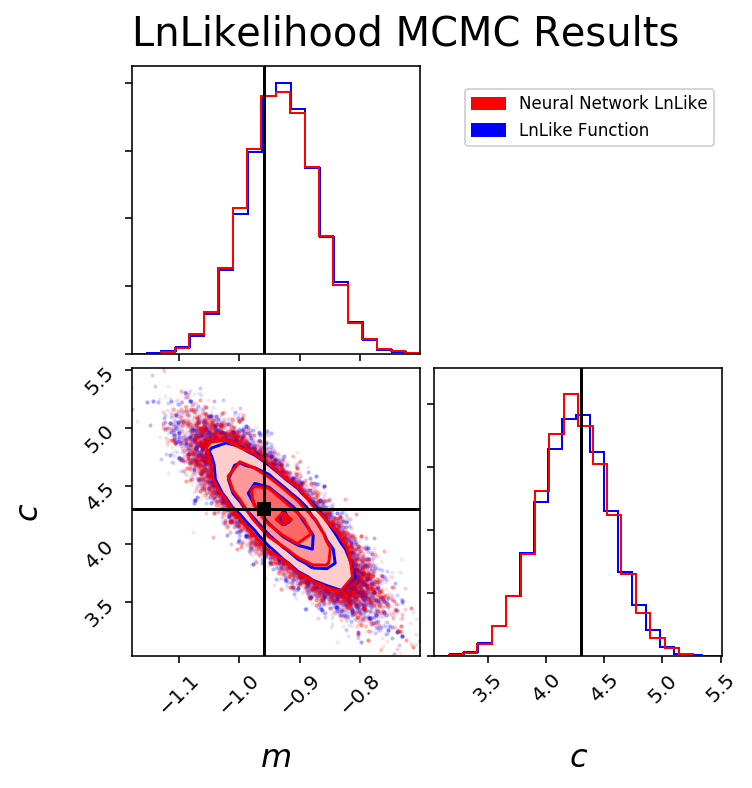

In [197]:
nn_samples, nn_samples_dataframe = get_mcmc_samples(
    load_previous_data=load_nn_mcmc_samples, 
    df_path=nn_samples_csv_p,
    np_path=nn_samples_np_p,
    ln_like_func=nn_ln_like,
    func_args=[model])

plot_two_corner_plots(samples1=samples, label1="LnLike Function", samples2=nn_samples, label2="NN LnLike")

## Multiple NN($d_i$) for $\ln \mathcal{L}(d_i|\theta)$ 

### Create NN and sample with NN

The idea is to calculate

> $\ln\mathcal{L}(d|\theta)  = \sum_i\ \ln\mathcal{L}(d_i|\theta) $, 

where each  $\mathcal{L}(d_i|\theta)$ is represented by a NN($d_i$) trained on samples from MCMC of $d_i$ .

Breaking this down into steps, we get

1.   Run MCMC on N chunks of data, $d_i\in d$ to get size(d)/N sets of estimates for $\mathcal{L}(d_i|\theta=\{m,c\})$.
2.   $\mathcal{L}(d_i|\theta=\{m,c\})$ samples as training data for a NN "interpolant" (ideally train in parallel)
3.   Calculate  $\ln\mathcal{L}(d|\theta)  = \sum_i\ \ln\mathcal{L}(d_i|\theta) =  \sum_i\ \text{NN}_i(d_i|\theta) $




In [0]:
good_chkpt = '/gdrive/My Drive/likelihoodToyModel/full_dataset/full/checkpoints_full/cp_full.ckpt'

In [0]:
def process_data_dicts(data_dicts):
  
  for idx, data_dictionary in enumerate(data_dicts):
  
    # Flags
    load_mcmc_samples = False
    load_model_data = False
    save_plot = True
    load_nn_mcmc_samples = False

    # File paths
    path_dict = make_data_folders(main_dir="di_dataset",id_str="d{}".format(idx))
    samples_csv_p=path_dict.get('samples_csv_p')
    samples_np_p=path_dict.get('samples_np_p')
    model_p=path_dict.get('model_p')
    hist_p=path_dict.get('hist_p')
    cp_p=path_dict.get('cp_p')
    training_acc_p=path_dict.get('training_acc_p')
    training_test_p=path_dict.get('training_test_p')
    nn_samples_csv_p=path_dict.get('nn_samples_csv_p')
    nn_samples_np_p=path_dict.get('nn_samples_np_p')

    # MCMC for lnLike training data
    samples, samples_dataframe = get_mcmc_samples(
        load_previous_data=load_mcmc_samples, 
        df_path=samples_csv_p,
        np_path=samples_np_p,
        ln_like_func=ln_like,
        func_args=[data_dict, line_model])

    # Train NN to estimate lnLike 
    model = get_model_from_samples(
      load_trained_model=load_model_data,
      samples_df=samples_dataframe,
      model_path=model_p,
      hist_path=hist_p, 
      checkpt_path=cp_p,
      train_path=training_acc_p,
      testing_path=training_test_p,
      save_plot=save_plot,
      transfer_learning_chk_path=good_chkpt)

    # MCMC from NN
    nn_samples, nn_samples_dataframe = get_mcmc_samples(
      load_previous_data=load_nn_mcmc_samples, 
      df_path=nn_samples_csv_p,
      np_path=nn_samples_np_p,
      ln_like_func=nn_ln_like,
      func_args=[model])
    
  pass





### Use NN samples to create lnLike

In [0]:
nn_df_paths = [
    '/gdrive/My Drive/likelihoodToyModel/di_dataset/d0/samples_d0_df.csv',
    '/gdrive/My Drive/likelihoodToyModel/di_dataset/d1/samples_d1_df.csv']
nn_np_paths = ['/gdrive/My Drive/likelihoodToyModel/di_dataset/d0/samples_d0_nparray.npy',
    '/gdrive/My Drive/likelihoodToyModel/di_dataset/d1/samples_d1_nparray.npy' ]

lnL_df_path = '/gdrive/My Drive/likelihoodToyModel/full_dataset/full/samples_full_df.csv'
lnLike_np_path = '/gdrive/My Drive/likelihoodToyModel/full_dataset/full/samples_full_nparray.npy'